https://www.coursera.org/learn/advanced-recommender-systems?action=enroll

https://www.eiturbanmobility.eu/smart-mobility-data-science-and-analytics/

In [3]:
epftoolbox

In [26]:
%run ts_processing.py
%run ts_modelling.py

<Figure size 3000x1500 with 0 Axes>

# Imports

In [54]:
import numpy as np
import pandas as pd
from datetime import datetime as dt
import matplotlib.pyplot as plt
import seaborn as sns

from sklearn.model_selection import KFold
from sklearn.model_selection import train_test_split
import time


from statsmodels.graphics.tsaplots import plot_acf, plot_pacf
import inspect
import warnings
warnings.filterwarnings("ignore")

from IPython.display import set_matplotlib_formats
set_matplotlib_formats('retina')
plt.style.use('seaborn-colorblind')
sns.set_theme()
%matplotlib inline
params = {'legend.fontsize': 'x-large',
          'figure.figsize': (20, 10),
          'figure.titlesize': 'x-large',
          'figure.dpi': 150,
         'axes.labelsize': 'x-large',
         'axes.titlesize': 'x-large',
         'xtick.labelsize': 'x-large',
         'ytick.labelsize': 'x-large',
         'savefig.bbox': 'tight'}

plt.rcParams.update(params)
# plt.rcParams.keys() ### Use to check the available parameters

KeysView(RcParams({'_internal.classic_mode': False,
          'agg.path.chunksize': 0,
          'animation.avconv_args': [],
          'animation.avconv_path': 'avconv',
          'animation.bitrate': -1,
          'animation.codec': 'h264',
          'animation.convert_args': [],
          'animation.convert_path': 'convert',
          'animation.embed_limit': 20.0,
          'animation.ffmpeg_args': [],
          'animation.ffmpeg_path': 'ffmpeg',
          'animation.frame_format': 'png',
          'animation.html': 'none',
          'animation.html_args': [],
          'animation.writer': 'ffmpeg',
          'axes.autolimit_mode': 'data',
          'axes.axisbelow': True,
          'axes.edgecolor': 'white',
          'axes.facecolor': '#EAEAF2',
          'axes.formatter.limits': [-5, 6],
          'axes.formatter.min_exponent': 0,
          'axes.formatter.offset_threshold': 4,
          'axes.formatter.use_locale': False,
          'axes.formatter.use_mathtext': False,
        

In [2]:
import statsmodels.api as sm

from statsmodels.graphics.tsaplots import plot_acf, plot_pacf
from statsmodels.tsa.statespace.tools import diff
from statsmodels.tsa.stattools import adfuller, kpss
from statsmodels.tsa.seasonal import seasonal_decompose

from pmdarima.arima import auto_arima

from sklearn.model_selection import TimeSeriesSplit
from sklearn.metrics import mean_squared_error
from statsmodels.tsa.arima.model import ARIMA

from sklearn.linear_model import Lasso, Ridge, ElasticNet
from sklearn.metrics import r2_score, mean_absolute_error, mean_squared_error

In [3]:
df = pd.read_csv("NordPool/NO1/Spot_price_NO1.csv")
df = df[["price", "datetime"]]
df["datetime"] = pd.to_datetime(df["datetime"])

In [4]:
df.head()

,price,datetime
0,29.36,2017-01-02 00:00:00
1,29.40,2017-01-02 01:00:00
2,28.91,2017-01-02 02:00:00
3,28.11,2017-01-02 03:00:00
4,28.24,2017-01-02 04:00:00


In [5]:
df.iloc[41592]

price                     85.27
datetime    2021-10-01 00:00:00
Name: 41592, dtype: object

In [6]:
tdat = df.iloc[:41592].copy() # Keep untouched From October 2021
tdat.tail()

,price,datetime
41587,104.97,2021-09-30 19:00:00
41588,107.66,2021-09-30 20:00:00
41589,103.34,2021-09-30 21:00:00
41590,96.47,2021-09-30 22:00:00
41591,94.50,2021-09-30 23:00:00


# Sationarity

In [7]:
plt.rcParams["figure.figsize"] = (20, 10)

In [8]:
test_data = df.iloc[41592:].copy()
test_data.head()

,price,datetime
41592,85.27,2021-10-01 00:00:00
41593,87.12,2021-10-01 01:00:00
41594,69.07,2021-10-01 02:00:00
41595,58.12,2021-10-01 03:00:00
41596,46.46,2021-10-01 04:00:00


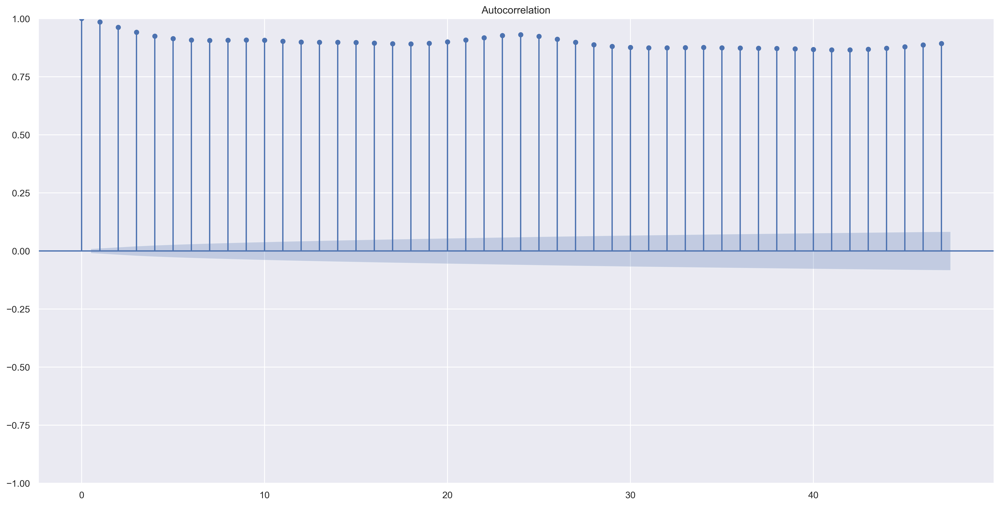

In [9]:
plot_acf(tdat["price"]);

In [13]:
tdiff = diff(tdat["price"], k_diff = 1, k_seasonal_diff  =None)

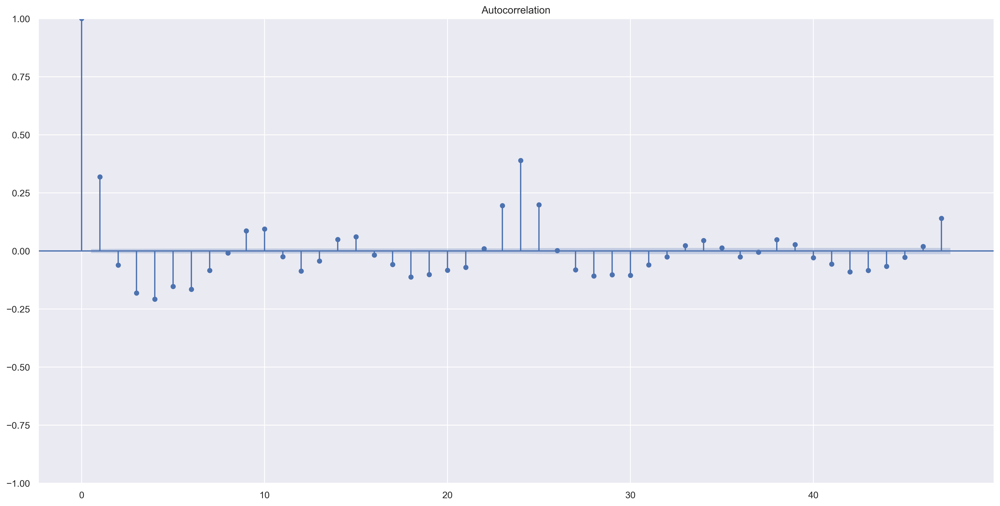

In [14]:
plot_acf(tdiff);

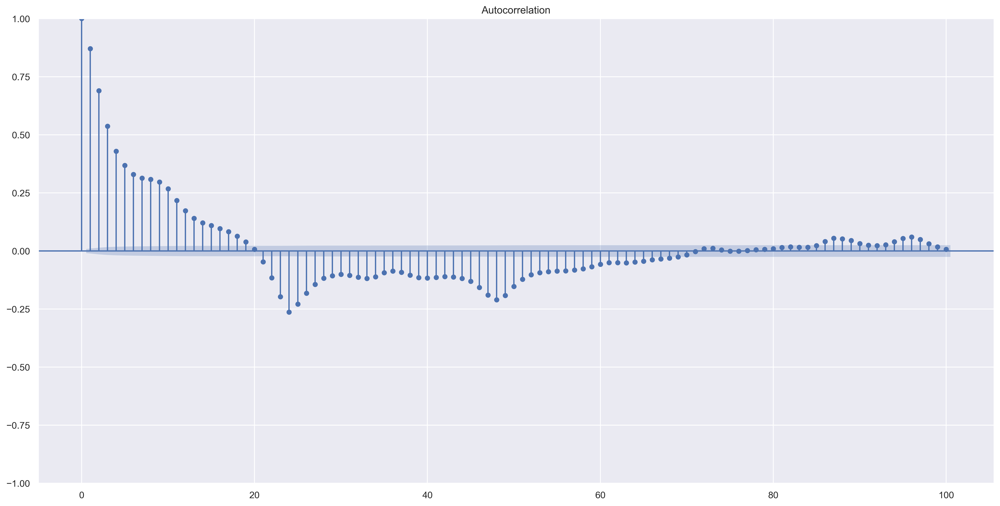

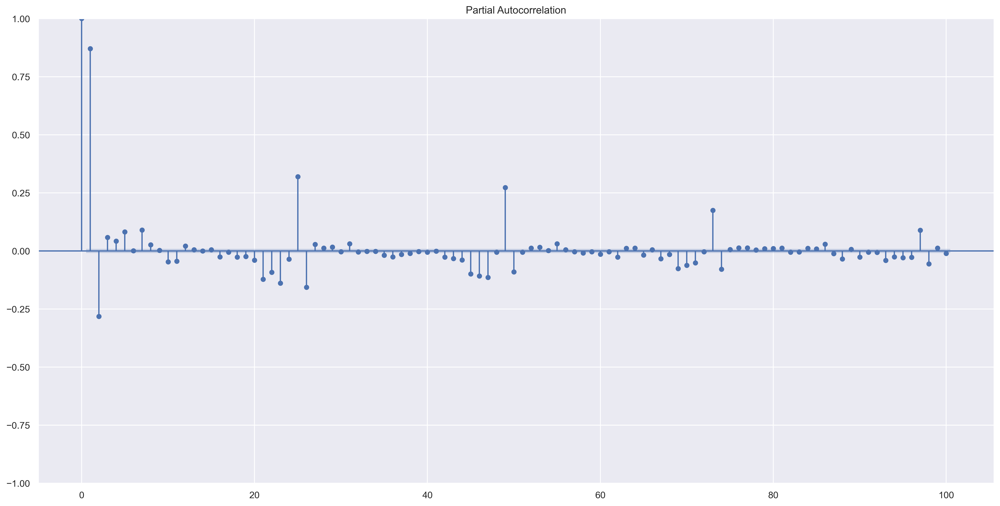

In [15]:
tdiff3 = diff(tdat["price"], k_diff = 0, k_seasonal_diff  =1, seasonal_periods = 24)
plot_acf(tdiff3, lags =100);
plot_pacf(tdiff3, lags =100);

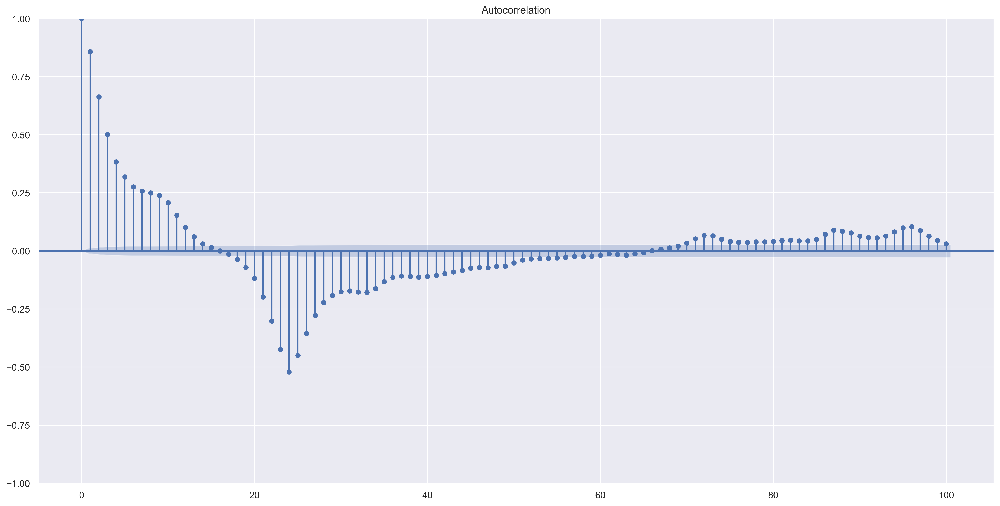

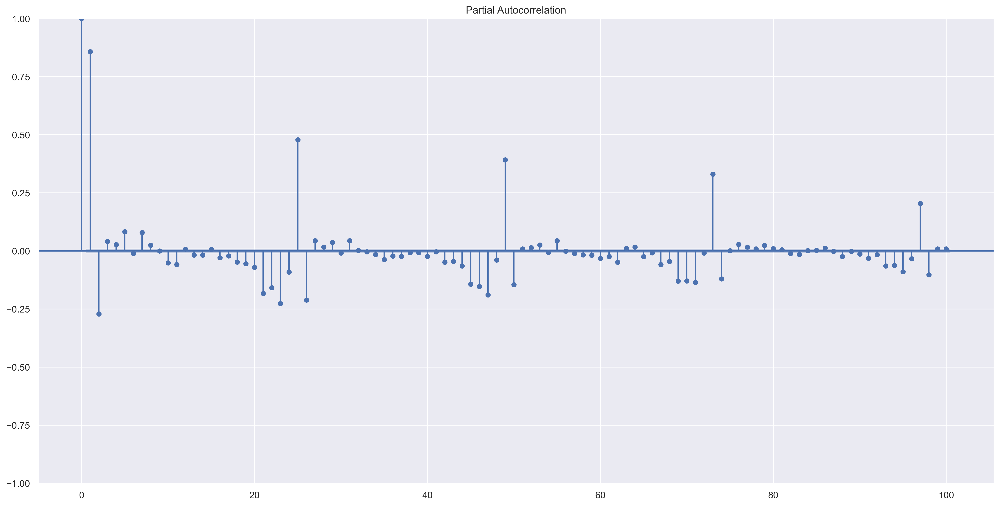

In [16]:
tdiff4 = diff(tdat["price"], k_diff = 0, k_seasonal_diff  =2, seasonal_periods = 24)
plot_acf(tdiff4, lags =100);
plot_pacf(tdiff4, lags =100);

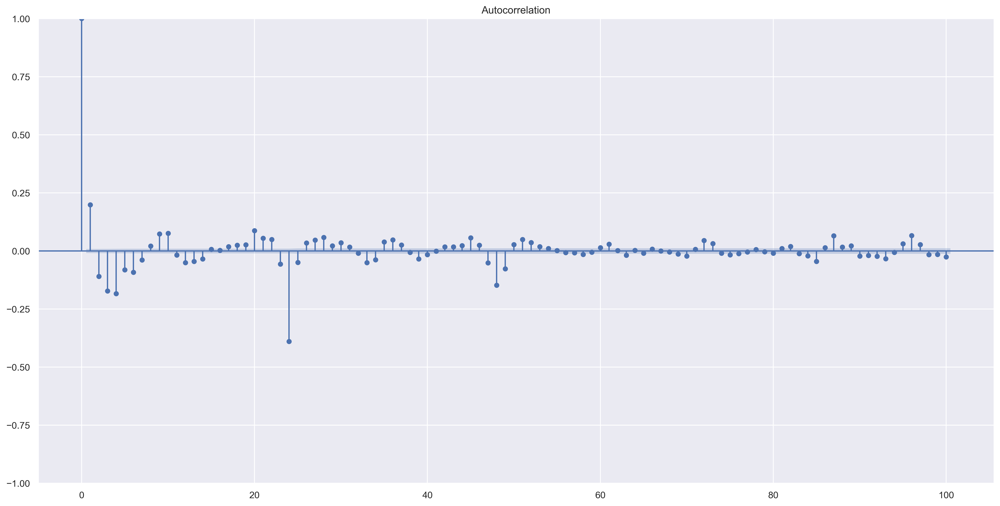

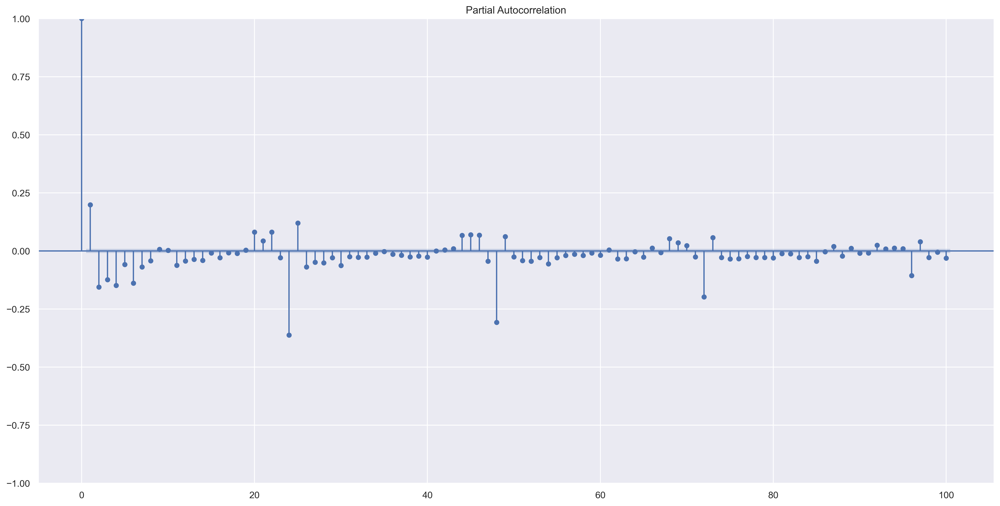

In [17]:
tdiff1 = diff(tdat["price"], k_diff = 1, k_seasonal_diff  =1, seasonal_periods = 24)
plot_acf(tdiff1, lags =100);
plot_pacf(tdiff1, lags =100);

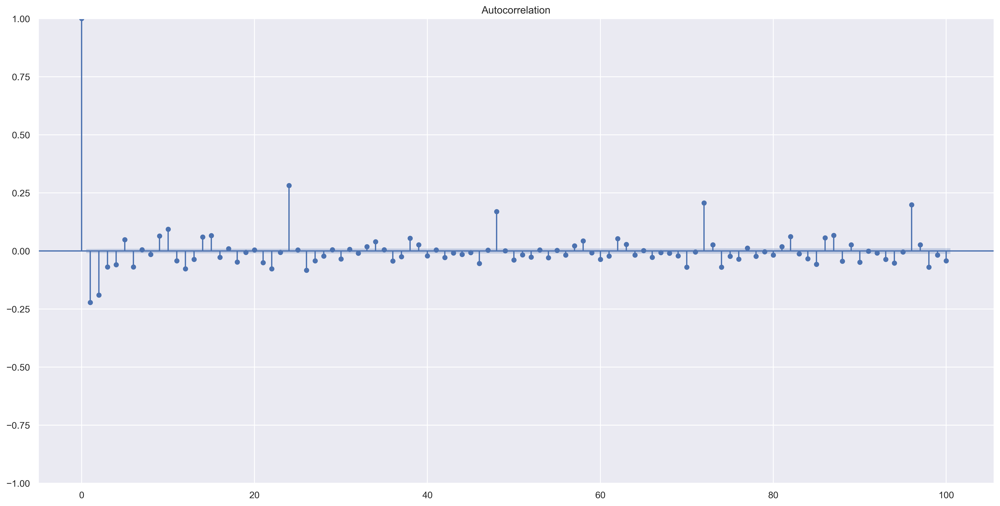

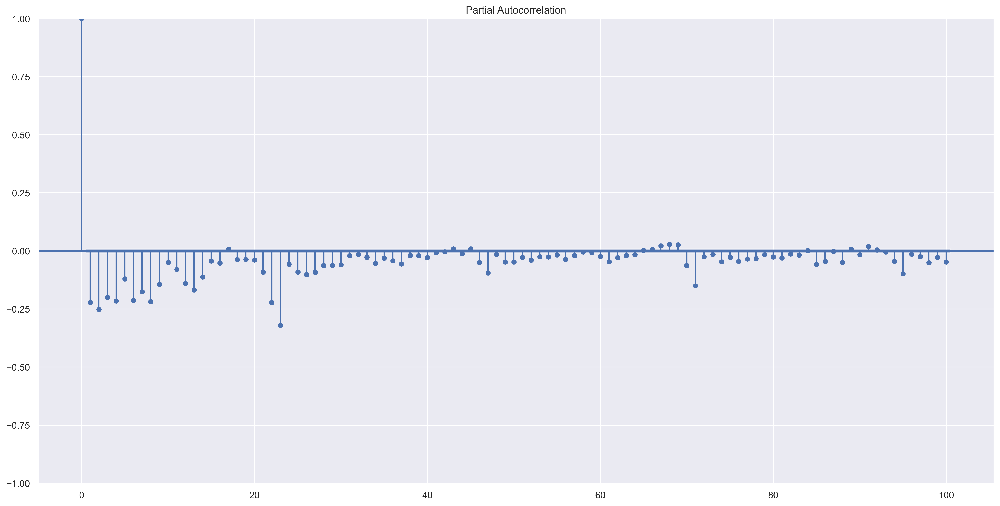

In [18]:
tdiff2 = diff(tdat["price"], k_diff = 2, k_seasonal_diff  =None)
plot_acf(tdiff2, lags = 100);
plot_pacf(tdiff2, lags = 100);

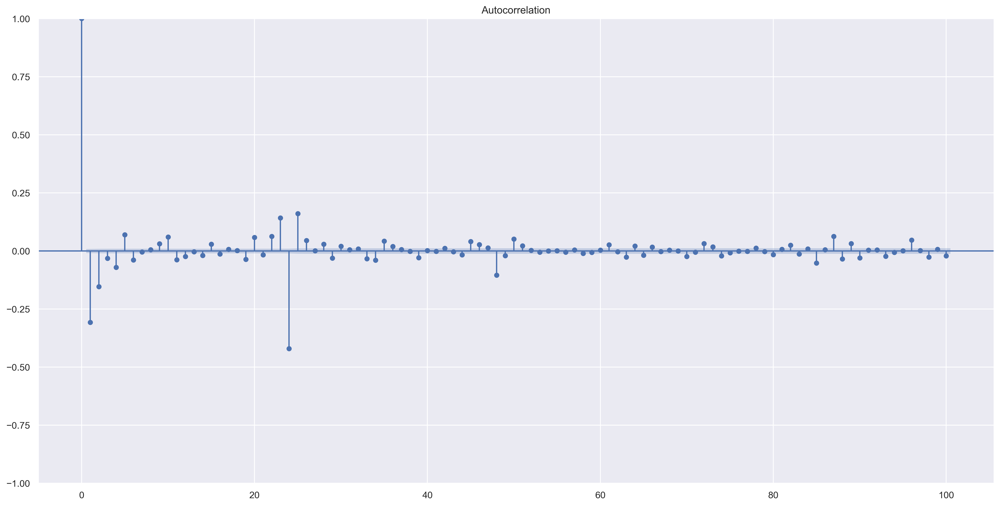

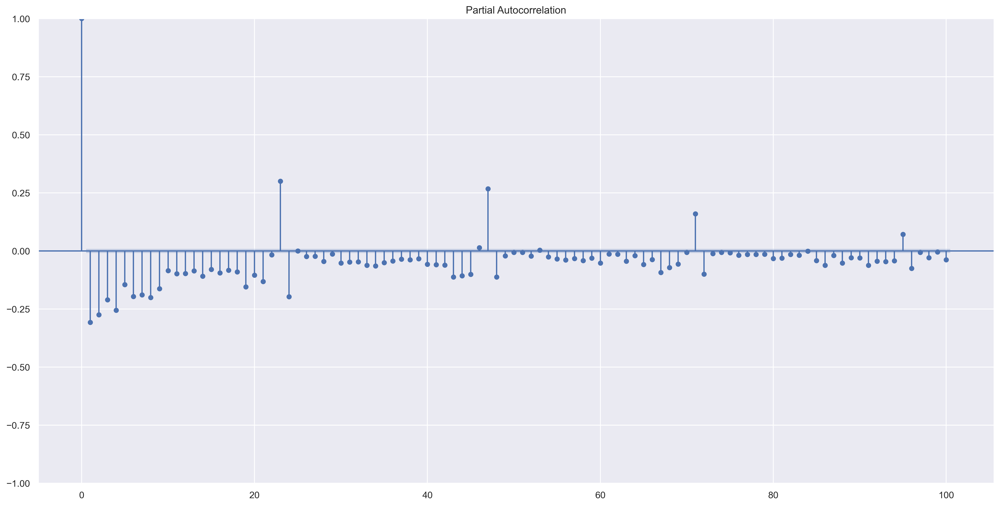

In [19]:
tdiff5 = diff(tdat["price"], k_diff = 2, k_seasonal_diff  =1, seasonal_periods =24 )
plot_acf(tdiff5, lags = 100);
plot_pacf(tdiff5, lags = 100);

The best fit is k=1, k_seasonal = 1

The decay is too strong, having momentum transferred for the next lags with differencing order´s greater thatn the selected.
The same goes the other way, with differencing orders smaller than the selected, where the decay and momentum is too smoth and the lags follow curves

In [20]:
print("p-value of the Augmented Dickey-Fuller test: ", adfuller(x = tdiff1.values), "\n")

print("p-value of the Kwiatkowski-Phillips-Schmidt-Shin test:", kpss(x = tdiff1.values))


p-value of the Augmented Dickey-Fuller test:  (-47.646076107865525, 0.0, 55, 41511, {'1%': -3.4305075414810733, '5%': -2.8616096297853653, '10%': -2.566807061686512}, 207193.4812084735) 

p-value of the Kwiatkowski-Phillips-Schmidt-Shin test: (0.0012995412430885202, 0.1, 112, {'10%': 0.347, '5%': 0.463, '2.5%': 0.574, '1%': 0.739})


In [21]:
tdiff1 = pd.Series(tdiff1)

In [22]:
display(tdiff1)

25      -0.28
26       0.21
27       0.58
28      -0.14
29      -0.53
         ... 
41587   -2.42
41588    3.19
41589   -2.14
41590    0.82
41591    4.19
Name: price, Length: 41567, dtype: float64

The ADF and KPSS tests confirm our hypothesis, it IS stationary with the selected differencing

# data Viz

In [58]:
price_dates = df.copy()
price_dates.reset_index(inplace = True)
price_dates["year"] = price_dates.datetime.dt.year
price_dates["month"] = price_dates.datetime.dt.month
price_dates = price_dates[price_dates.year != 2022]

In [59]:
pivot1 = pd.pivot_table(price_dates, index = "month", columns = "year", values = "price")
pivot2 = pd.pivot_table(price_dates, index = "month", columns = "year", values = "price", aggfunc = np.sum)
pivot3 = pd.pivot_table(price_dates, index = "month", columns = "year", values = "price", aggfunc = min)
pivot4 = pd.pivot_table(price_dates, index = "month", columns = "year", values = "price", aggfunc = max)


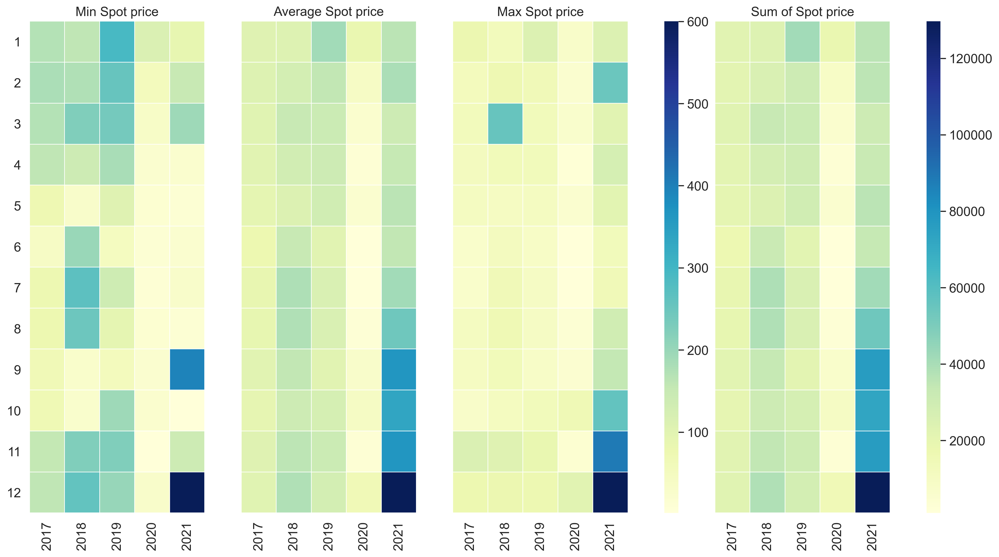

In [67]:
plt.rcParams.update(params) ### Update visual parameters

f,(ax1,ax2,ax3,axca,ax4,axcb) = plt.subplots(1,6, 
            gridspec_kw={'width_ratios':[1,1,1,0.08,1,0.08]})
plt.subplots_adjust(left = 0.2, wspace=0.3)
ax1.get_shared_y_axes().join(ax2,ax3,ax4)
g1 = sns.heatmap(pivot3,cmap="YlGnBu",cbar=False,ax=ax1, annot = False, fmt = "f", linewidth = .5)
g1.set_ylabel('')
g1.set_xlabel('')
g1.set_title("Min Spot price")
g2 = sns.heatmap(pivot1,cmap="YlGnBu",cbar = False,ax=ax2, annot = False, fmt = "f", linewidth = .5)
g2.set_ylabel('')
g2.set_xlabel('')
g2.set_yticks([])
g2.set_title("Average Spot price")
g3 = sns.heatmap(pivot4,cmap="YlGnBu",ax=ax3, cbar_ax=axca, annot = False, fmt = "f", linewidth = .5)
g3.set_ylabel('')
g3.set_xlabel('')
g3.set_yticks([])
g3.set_title("Max Spot price")
g4 = sns.heatmap(pivot2,cmap="YlGnBu",ax=ax4, cbar_ax=axcb, annot = False, fmt = "f", linewidth = .5)
g4.set_ylabel('')
g4.set_xlabel('')
g4.set_yticks([])
g4.set_title("Sum of Spot price")

# may be needed to rotate the ticklabels correctly:
for ax in [g1,g2,g3, g4]:
    tl = ax.get_xticklabels()
    ax.set_xticklabels(tl, rotation=90)
    tly = ax.get_yticklabels()
    ax.set_yticklabels(tly, rotation=0)
plt.savefig(f'Plots/YearMonth price overview.jpg')
plt.show()

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2-D array with a single row if you intend to specify the same RGB or RGBA value for all points.


<AxesSubplot:xlabel='y(t)', ylabel='y(t + 1)'>

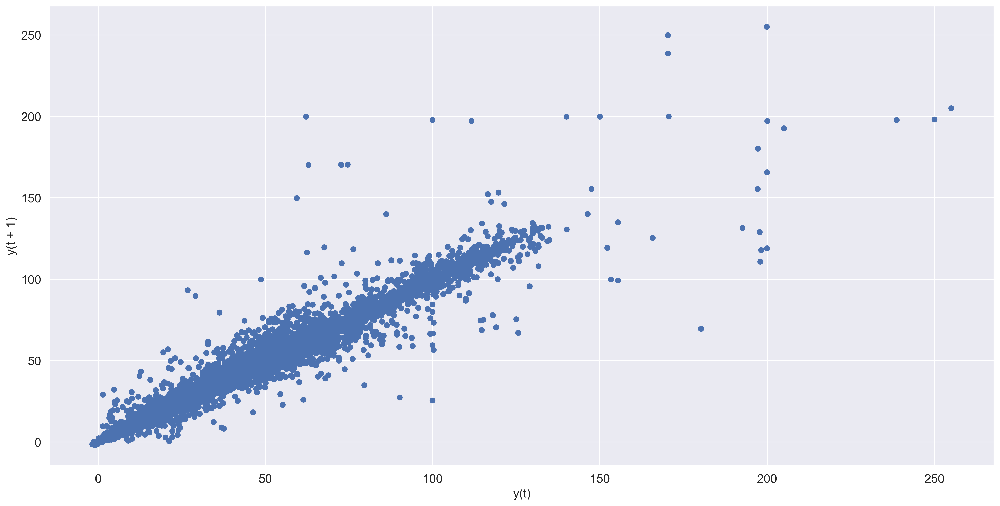

In [44]:
from pandas.plotting import lag_plot
lag_plot(tdat["price"])

# Modelling

In [16]:
from statsmodels.tsa.arima.model import ARIMA

In [10]:
### Baseline ###
tdat.set_index("datetime", inplace = True)
tdat.head()

,price
datetime,
2017-01-02 00:00:00,29.36
2017-01-02 01:00:00,29.40
2017-01-02 02:00:00,28.91
2017-01-02 03:00:00,28.11
2017-01-02 04:00:00,28.24


In [11]:
tnorm = tdat.copy()
basedf = tdat.copy()
tnorm.head()

,price
datetime,
2017-01-02 00:00:00,29.36
2017-01-02 01:00:00,29.40
2017-01-02 02:00:00,28.91
2017-01-02 03:00:00,28.11
2017-01-02 04:00:00,28.24


In [12]:
p_min = tdat["price"].min()
p_max = tdat["price"].max()
tdat["price"] = (tdat["price"] - p_min)/(p_max-p_min) # Values between 0 and 1
tdat.head()

,price
datetime,
2017-01-02 00:00:00,0.121091
2017-01-02 01:00:00,0.121246
2017-01-02 02:00:00,0.119338
2017-01-02 03:00:00,0.116222
2017-01-02 04:00:00,0.116728


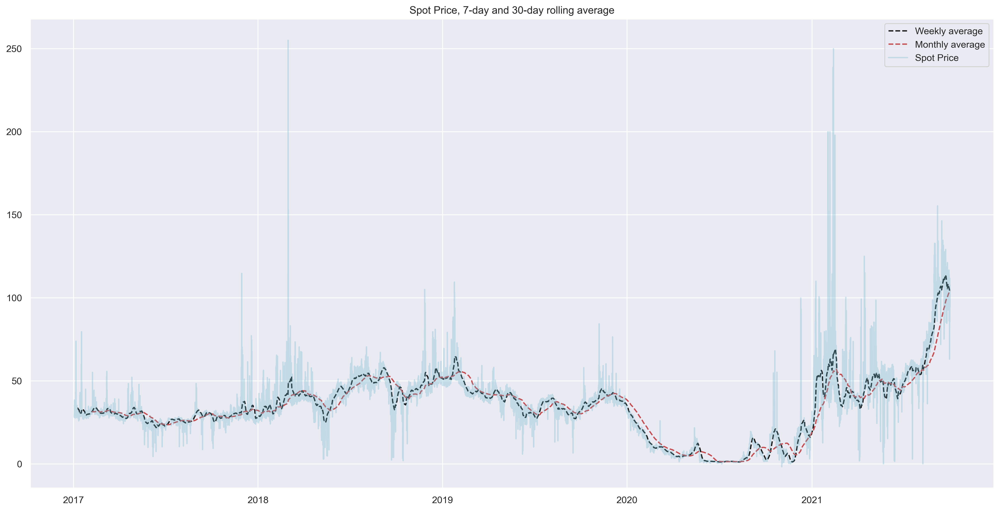

In [13]:
tnorm["rollingw"] = tnorm.price.rolling(168).mean() # Weekly average
tnorm["rollingm"] = tnorm.price.rolling(840).mean() # Monthly average
plt.plot(tnorm.rollingw, "k--", label = "Weekly average")
plt.plot(tnorm.rollingm, "r--", label  ="Monthly average")
plt.plot(tnorm.price, "c", alpha = 0.3, label = "Spot Price")
plt.title("Spot Price, 7-day and 30-day rolling average")
plt.legend()
plt.savefig("Plots/Spot Price, 7-day and 30-day rolling average")
plt.show()

In [ ]:
mod = ARIMA(tdat, order=(0, 0, 1))
res = mod.fit()
print(res.params)

<AxesSubplot:>

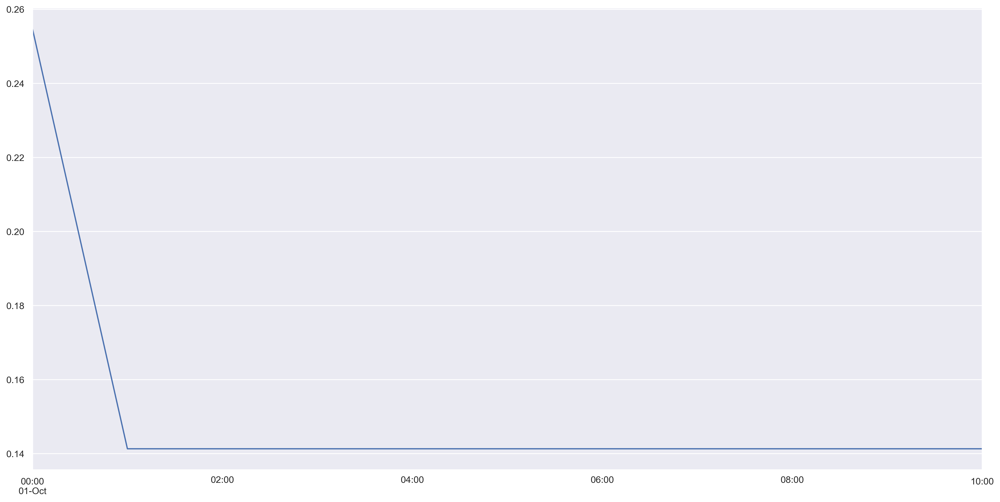

In [17]:
res.predict(start ="2021-10-01 00:00:00", end = "2021-10-01 10:00:00").plot()


# Forecasting

## Baselines

Base1 is taking into account hour, day and month
Base2 is taking into account hour and day
Base3 is taking into account hour

In [14]:
plt.rcParams["figure.figsize"] = (20, 10)

In [15]:
#basedf = tnorm.copy()

In [16]:
######### Prepare dataframe to get Baselines #########
basedf.reset_index(inplace = True)
basedf.columns = ["datetime", "Naive price"]
basedf["hour"] = basedf["datetime"].dt.hour
basedf["dayofweek"] = basedf["datetime"].dt.weekday
basedf["month"] = basedf["datetime"].dt.month
basedf["day"] = basedf["datetime"].dt.day
basedf.head()

,datetime,Naive price,hour,dayofweek,month,day
0,2017-01-02 00:00:00,29.36,0,0,1,2
1,2017-01-02 01:00:00,29.40,1,0,1,2
2,2017-01-02 02:00:00,28.91,2,0,1,2
3,2017-01-02 03:00:00,28.11,3,0,1,2
4,2017-01-02 04:00:00,28.24,4,0,1,2


In [17]:
# Get Dataframes that correspond to increasingly simple baselines
base1 = basedf.groupby(["month", "day", "hour"])["Naive price"].mean()
base1.to_csv("Plots/Baselines/base1.csv")
base2 = basedf.groupby(["day", "hour"])["Naive price"].mean()
base2.to_csv("Plots/Baselines/base2.csv")
base3 = basedf.groupby(["hour"])["Naive price"].mean()
base3.to_csv("Plots/Baselines/base3.csv")

In [18]:
tnorm=tnorm[["price"]].reset_index()

In [19]:
tnorm["hour"] = tnorm["datetime"].dt.hour
tnorm["month"] = tnorm["datetime"].dt.month
tnorm["day"] = tnorm["datetime"].dt.day

In [20]:
#Merge tnorm and base1 on month, day, hour
base1 = pd.merge(tnorm, base1, how = "left", on = ["month", "day", "hour"])
base1.head()

,datetime,price,hour,month,day,Naive price
0,2017-01-02 00:00:00,29.36,0,1,2,31.950
1,2017-01-02 01:00:00,29.40,1,1,2,32.166
2,2017-01-02 02:00:00,28.91,2,1,2,31.624
3,2017-01-02 03:00:00,28.11,3,1,2,31.456
4,2017-01-02 04:00:00,28.24,4,1,2,31.112


In [21]:
#Merge tnorm and base1 on month, day, hour
base2 = pd.merge(tnorm, base2, how = "left", on = ["day", "hour"])
base2.head()

,datetime,price,hour,month,day,Naive price
0,2017-01-02 00:00:00,29.36,0,1,2,32.102105
1,2017-01-02 01:00:00,29.40,1,1,2,32.169649
2,2017-01-02 02:00:00,28.91,2,1,2,31.437719
3,2017-01-02 03:00:00,28.11,3,1,2,30.935789
4,2017-01-02 04:00:00,28.24,4,1,2,30.690877


In [22]:
#Merge tnorm and base1 on month, day, hour
base3 = pd.merge(tnorm, base3, how = "left", on = ["hour"])
base3.set_index('datetime', inplace=True)
base3.head()

,price,hour,month,day,Naive price
datetime,,,,,
2017-01-02 00:00:00,29.36,0,1,2,32.753324
2017-01-02 01:00:00,29.40,1,1,2,32.553237
2017-01-02 02:00:00,28.91,2,1,2,31.678806
2017-01-02 03:00:00,28.11,3,1,2,31.070606
2017-01-02 04:00:00,28.24,4,1,2,30.787409


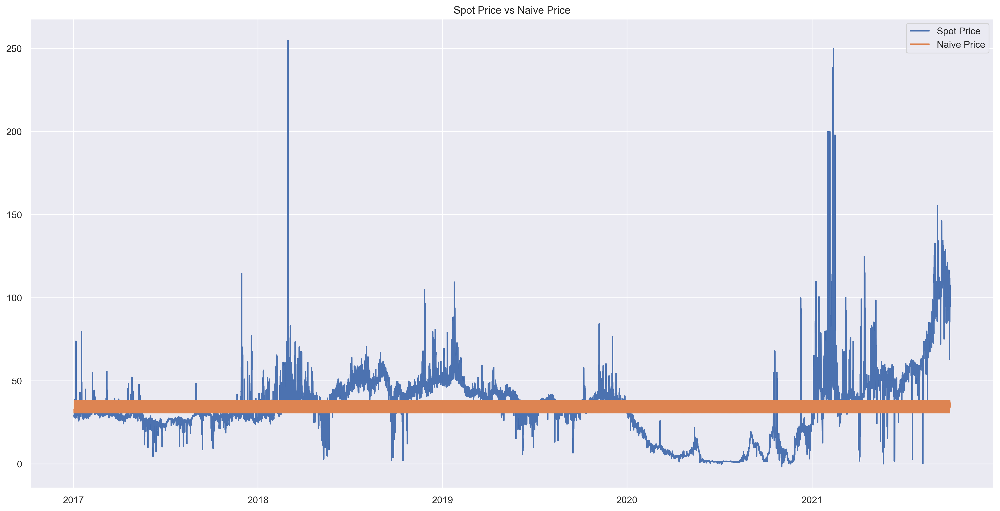

In [23]:
plt.plot(base3["price"], label = "Spot Price")
plt.plot(base3["Naive price"], label = "Naive Price")
plt.legend()
plt.title("Spot Price vs Naive Price")
plt.show()

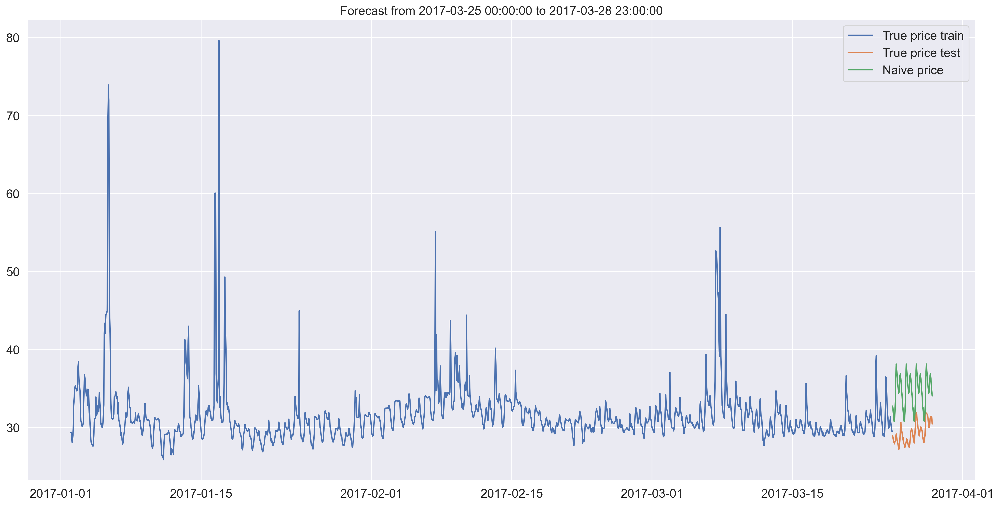

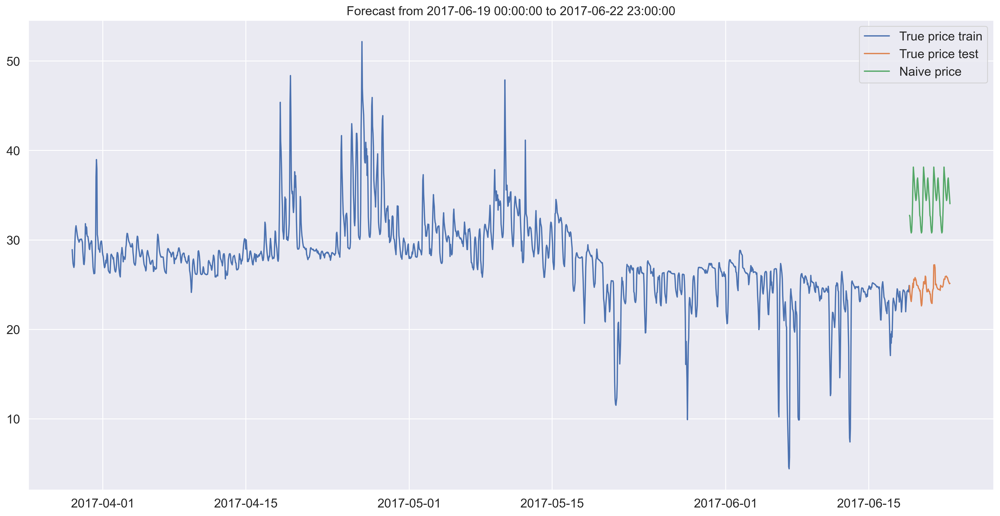

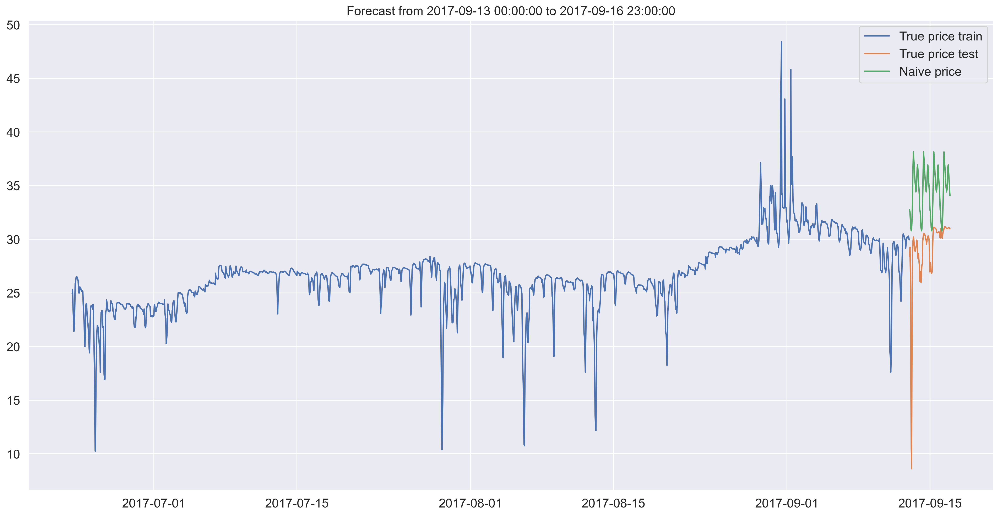

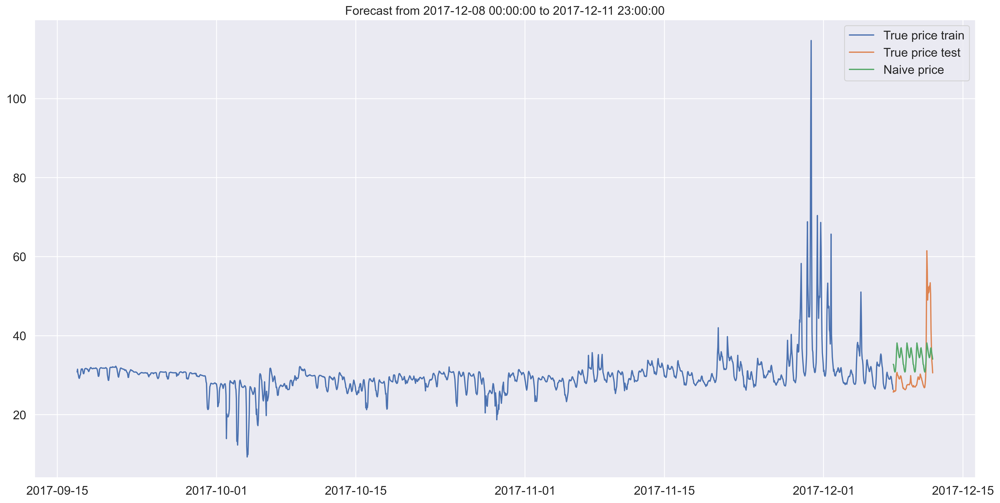

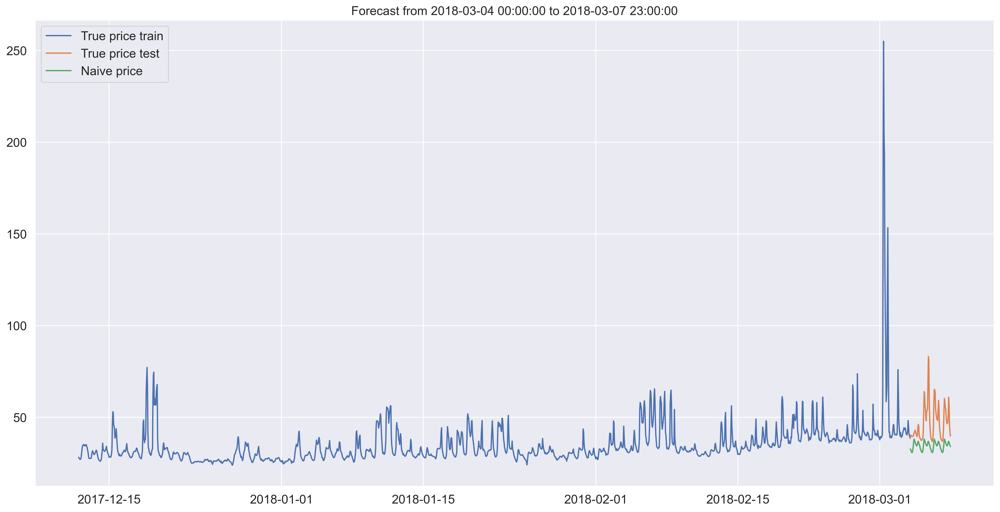

...

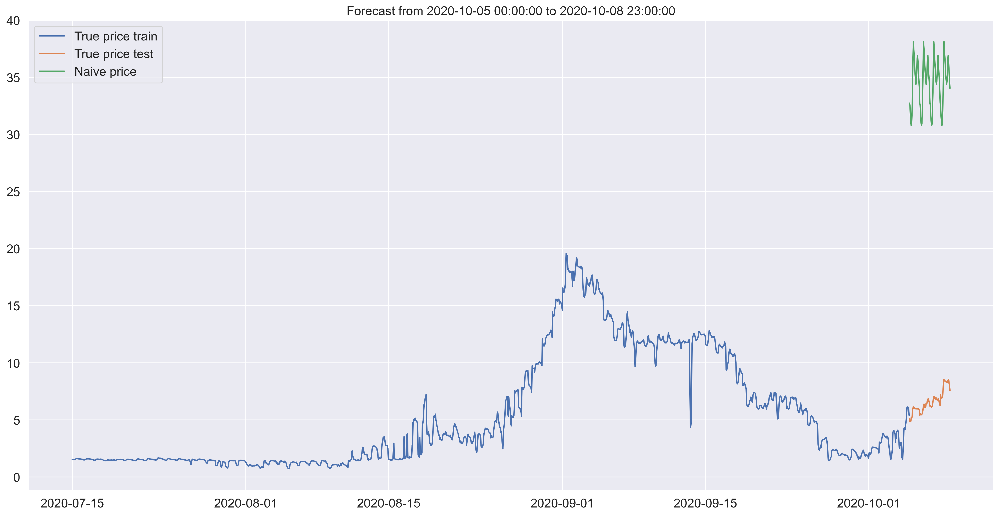

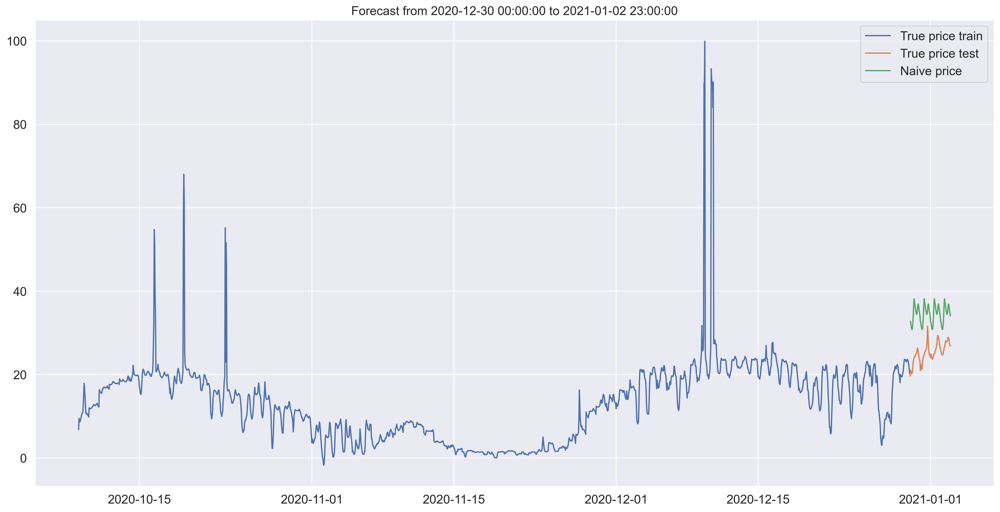

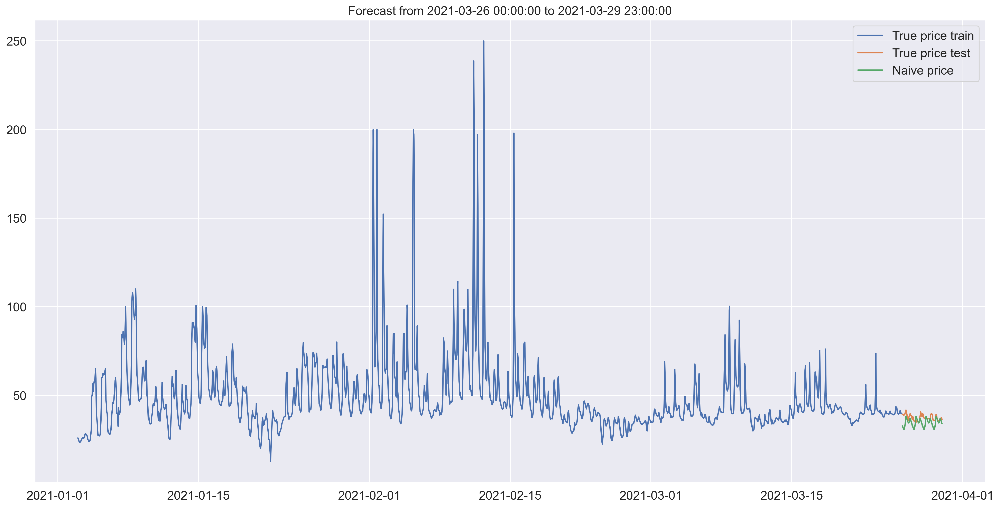

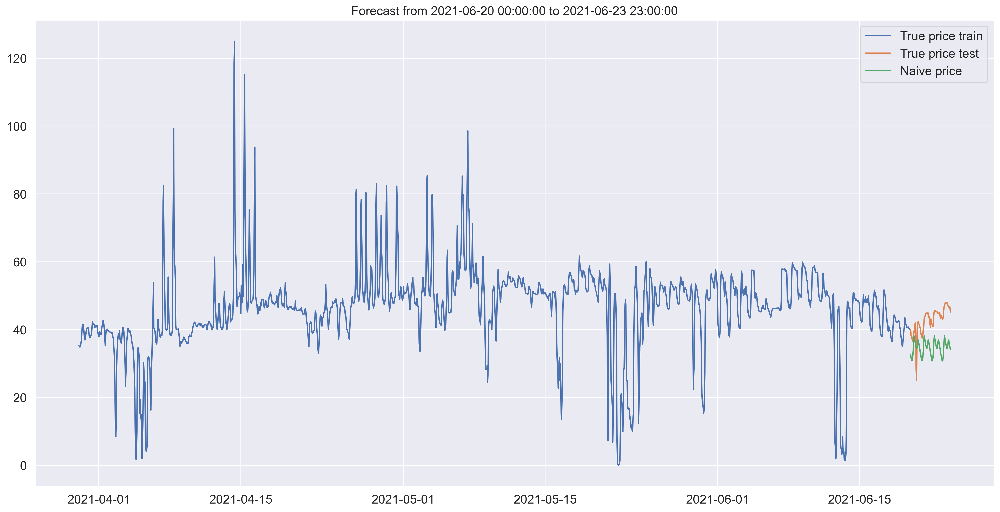

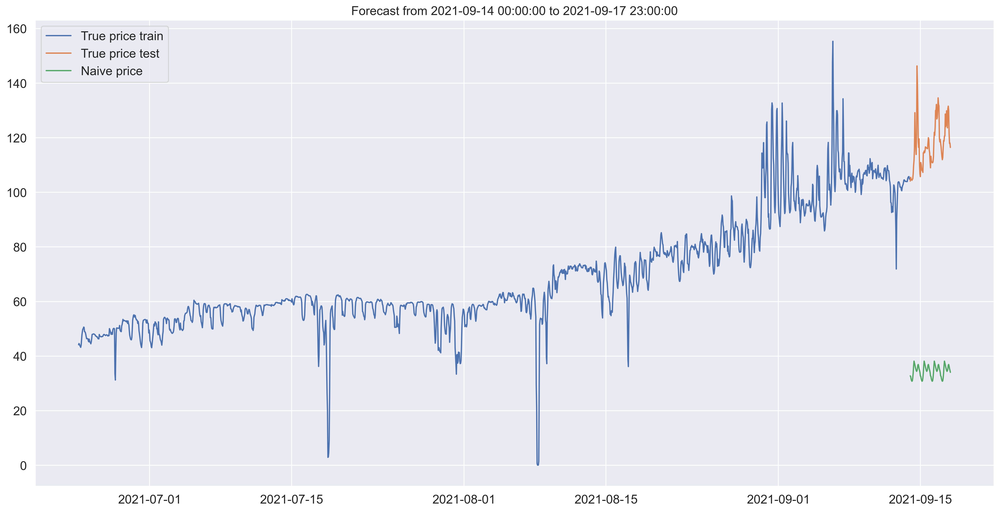

In [68]:
    folds = 20
    for ii in range(folds):
        fig = plt.figure(figsize=(20,10))
        plt.plot(base3[(indexes[ii][0]-train_size):indexes[ii][0]]["price"], label = "True price train")
        plt.plot(base3[indexes[ii][0]:indexes[ii][1]]["price"], label = "True price test")
        plt.plot(base3[indexes[ii][0]:indexes[ii][1]]["Naive price"], label = "Naive price")
        plt.title(f'Forecast from {base3[indexes[ii][0]:indexes[ii][1]].index[0]} to {base3[indexes[ii][0]:indexes[ii][1]].index[-1]}')
        plt.legend()
        fig.savefig(f'Plots/Naive prediction 3 Fold {ii+1}.jpg')
        plt.show()

## Prediction

In [27]:
####### Initialize data for the predictions ########

test_size = 96 # 4 days
train_size = 1968 # 82 days
folds = 20 # 20 folds
preds = []
rmse = []
indexes = []

In [28]:
preds, nrmse, indexes = seasonal_arima(tdat, train_size, test_size, folds, order =(0,1,0), seasonal_order=(0,1,0, 24))

Fold 1: train index (0), test_index (1968)
Fold 2: train index (2064), test_index (4032)
Fold 3: train index (4128), test_index (6096)
Fold 4: train index (6192), test_index (8160)
Fold 5: train index (8256), test_index (10224)
Fold 6: train index (10320), test_index (12288)
Fold 7: train index (12384), test_index (14352)
Fold 8: train index (14448), test_index (16416)
Fold 9: train index (16512), test_index (18480)
Fold 10: train index (18576), test_index (20544)
Fold 11: train index (20640), test_index (22608)
Fold 12: train index (22704), test_index (24672)
Fold 13: train index (24768), test_index (26736)
Fold 14: train index (26832), test_index (28800)
Fold 15: train index (28896), test_index (30864)
Fold 16: train index (30960), test_index (32928)
Fold 17: train index (33024), test_index (34992)
Fold 18: train index (35088), test_index (37056)
Fold 19: train index (37152), test_index (39120)
Fold 20: train index (39216), test_index (41184)
RMSE: 0.021796086188250168


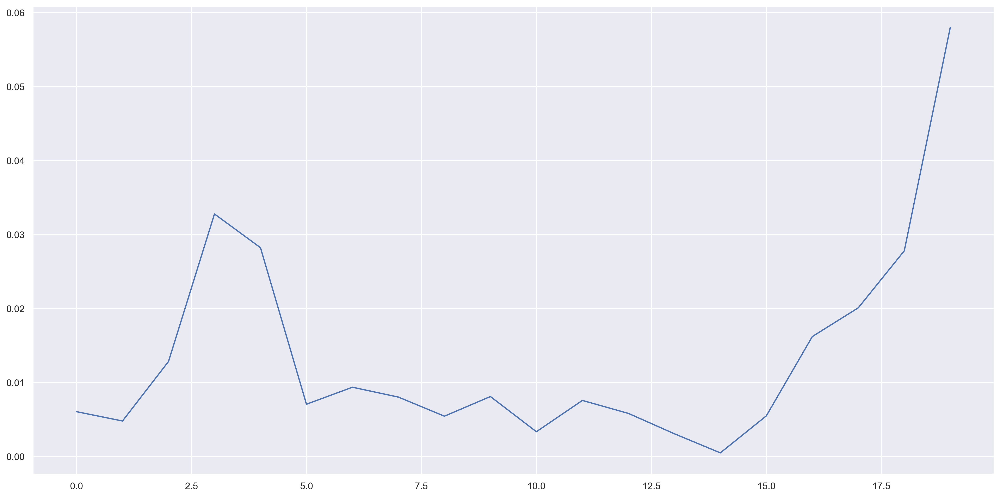

In [155]:
plt.plot(nrmse) # NRMSE is __NOT__ the same that RMSE

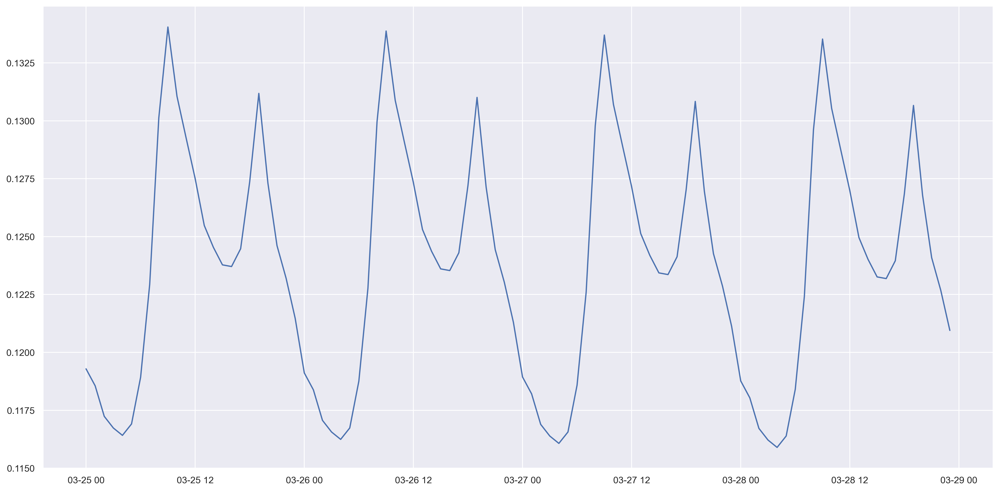

In [156]:
plt.plot(preds[0])

## De-Normalization

In [30]:
########### De-Normalization ###########

tdat["price"] = (tdat["price"]*(p_max-p_min) + p_min)
predsd=[]
predsd = [(pred*(p_max - p_min) + p_min) for pred in preds]
print(predsd[0])

2017-03-25 00:00:00    28.470000
2017-03-25 01:00:00    27.920000
2017-03-25 02:00:00    27.870000
2017-03-25 03:00:00    28.090000
2017-03-25 04:00:00    27.750000
                         ...    
2017-03-28 19:00:00    26.899999
2017-03-28 20:00:00    26.179999
2017-03-28 21:00:00    25.569999
2017-03-28 22:00:00    25.349999
2017-03-28 23:00:00    25.019999
Freq: H, Name: predicted_mean, Length: 96, dtype: float64


## Plotting

The SARIMAX order is ((1,1,0)(0,1,1,24))


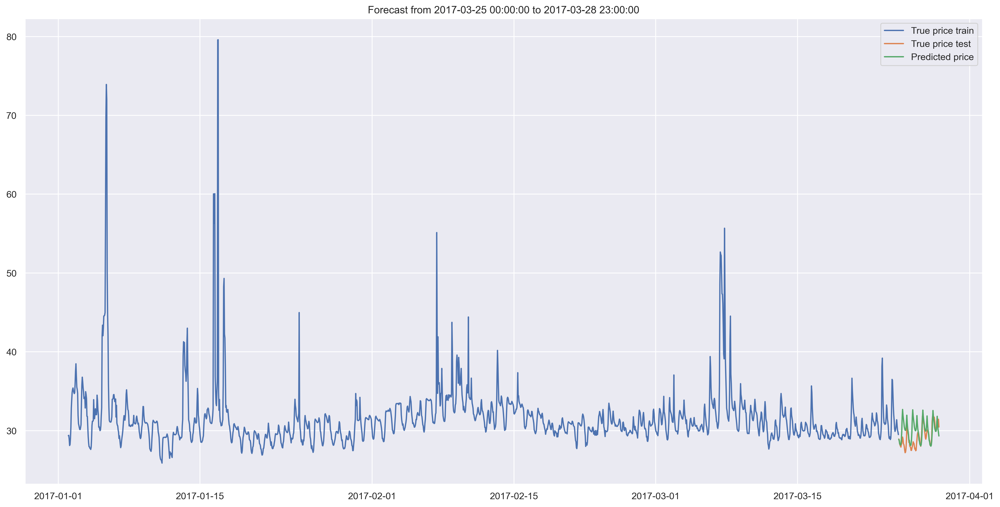

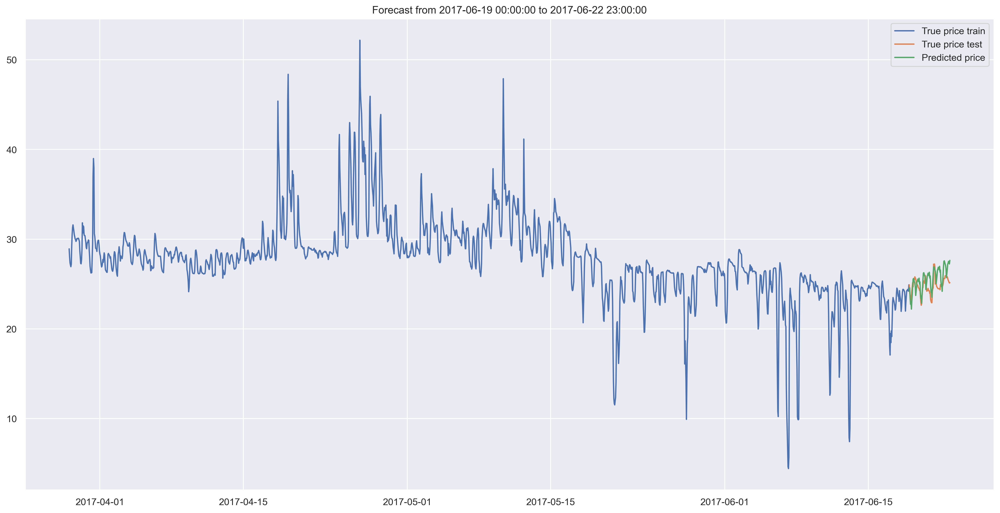

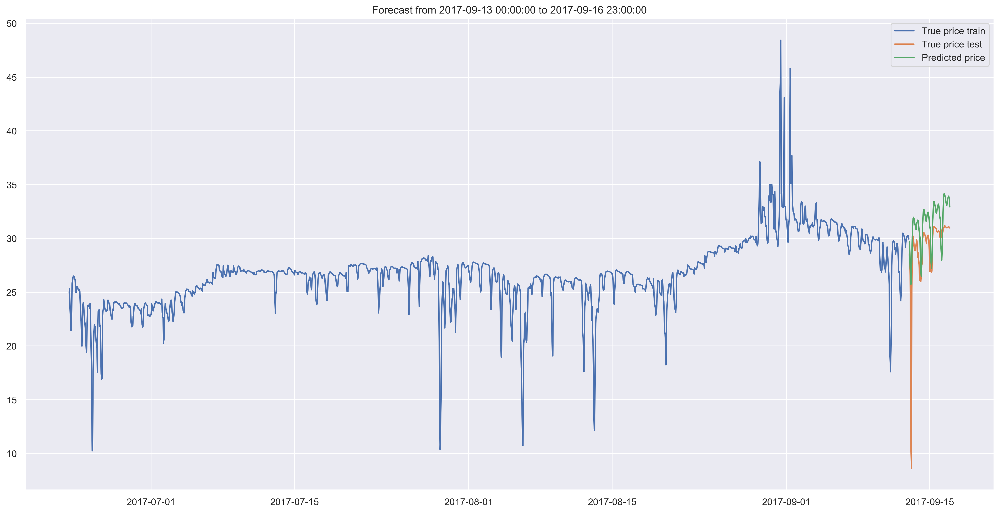

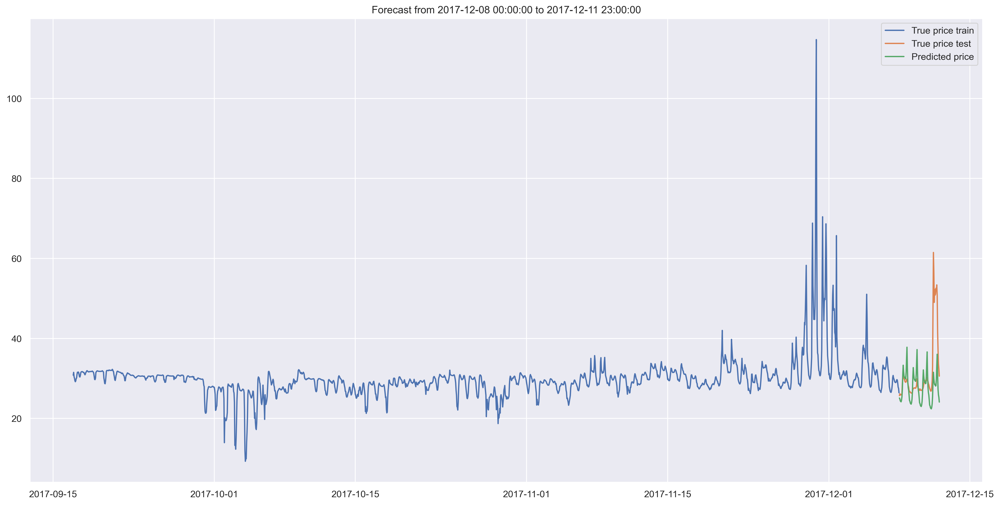

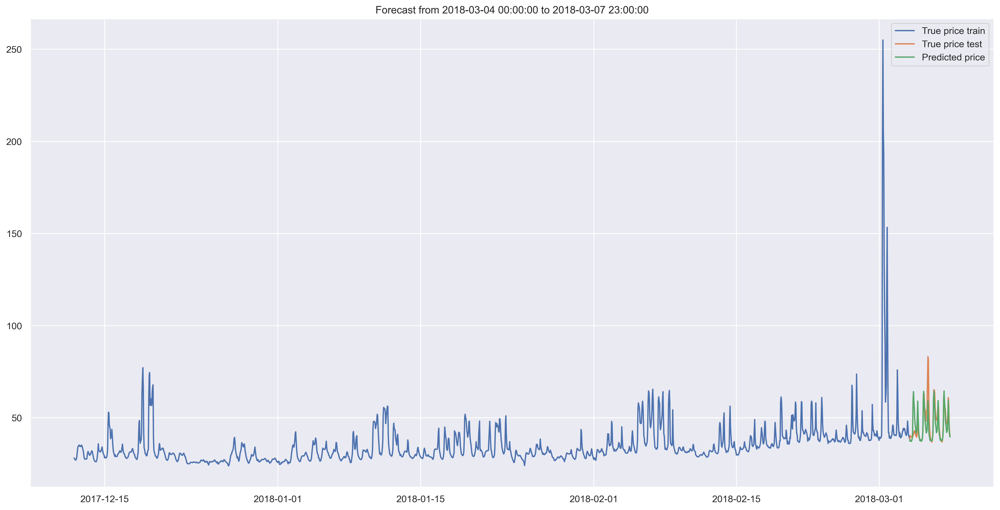

...

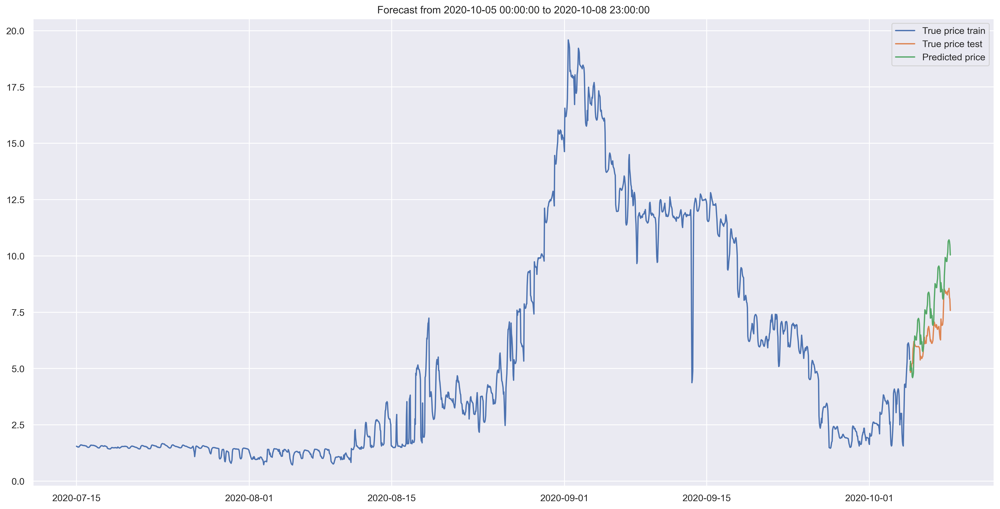

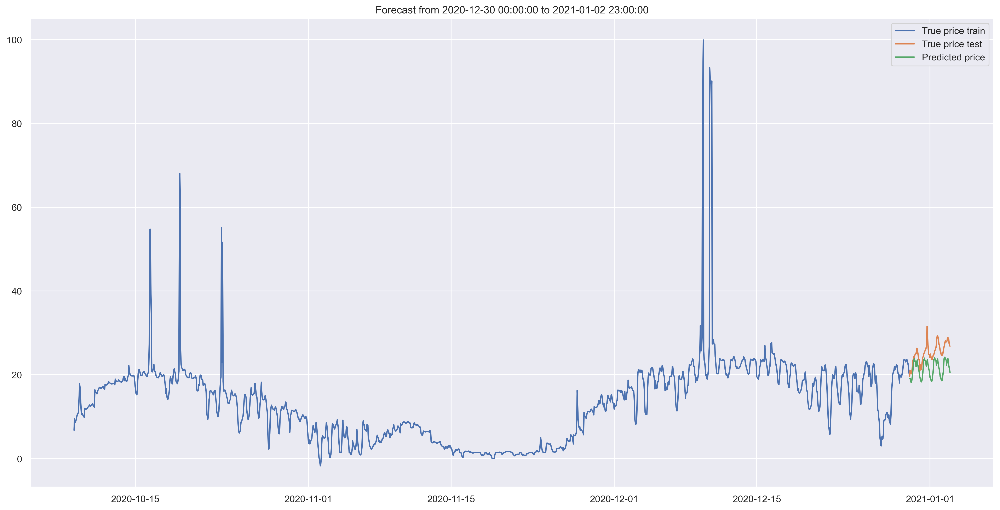

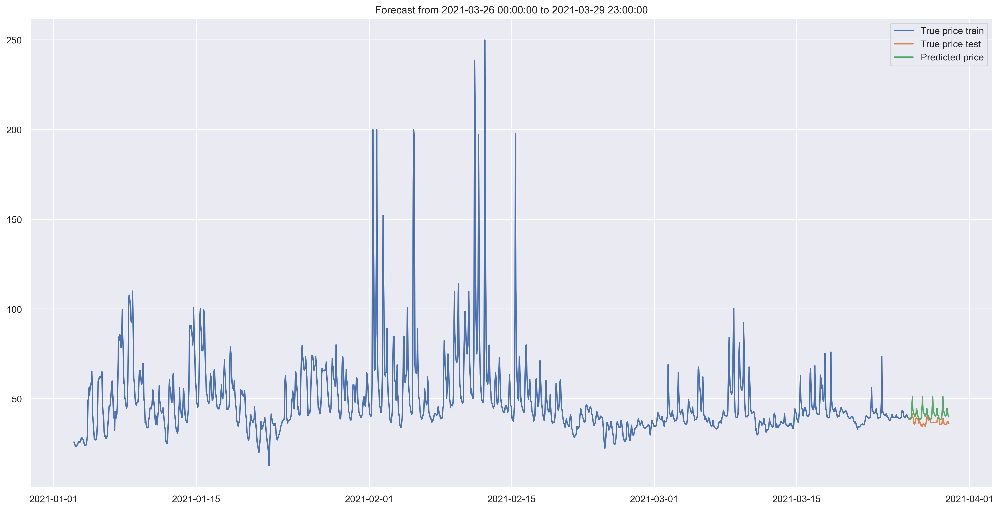

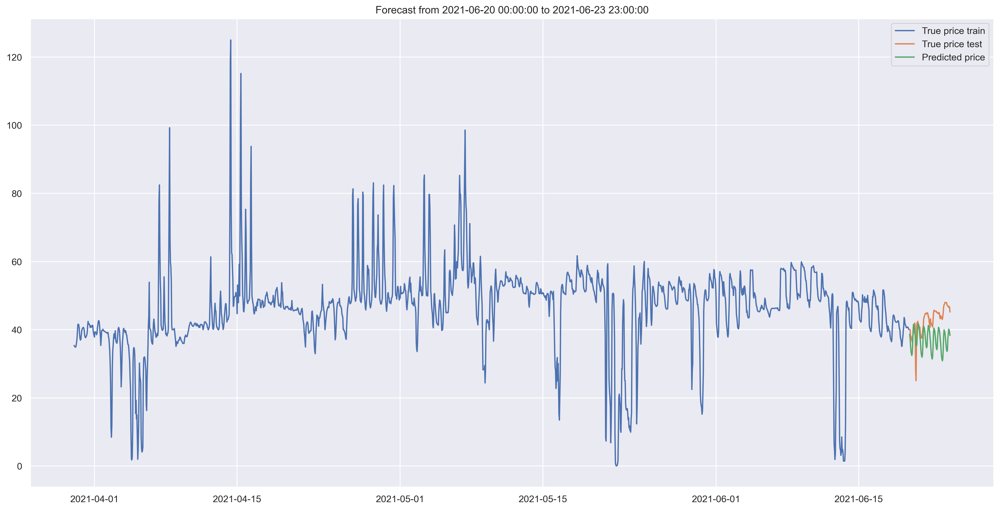

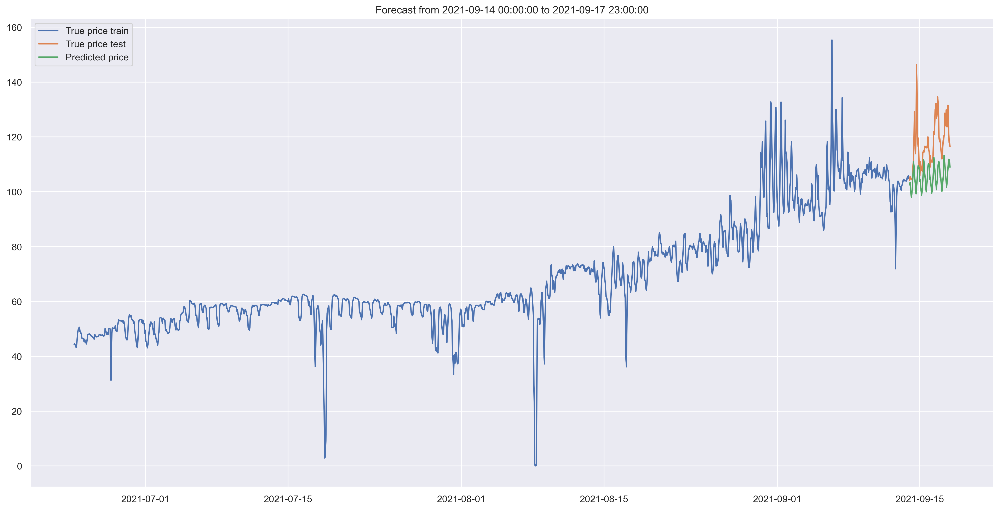

In [158]:
my_order = "((1,1,0)(0,1,1,24))"
plot_preds(tdat, predsd, indexes, 1968, 20, order = my_order)

# Forecasting with Auto Arima

automod = auto_arima(tdat, start_p=1, start_q=1, max_p=3, max_q=3,
                     m=24, start_P=1, seasonal=True, d=1, D=1, trace=True,
                     error_action='ignore',  # don't want to know if an order does not work
                     suppress_warnings=True,  # don't want convergence warnings
                     stepwise=True)

# Evaluation

## RMSE

In [31]:
###### De-normalized RMSE ######
rmse = []
rmse = [(np.sqrt(mean_squared_error(
    tdat[indexes[ii][0]:indexes[ii][1]], predsd[ii])))
                 for ii in range(folds)]
rmse[0] # Check that it is not in the 0.01 range

2.953568728609201

Below 2 cells are only for Baselines

In [32]:
###### De-normalized RMSE ######
rmse = []
rmse = [(np.sqrt(mean_squared_error(
    base3[indexes[ii][0]:indexes[ii][1]]["price"], base3[indexes[ii][0]:indexes[ii][1]]["Naive price"])))
                 for ii in range(folds)]
rmse[0] # Check that it is not in the 0.01 range

5.609423328370936

Fold 1 has  a MAPE of 18.16 % and an RMSE of 5.6094
Fold 2 has  a MAPE of 39.28 % and an RMSE of 9.8886
Fold 3 has  a MAPE of 21.84 % and an RMSE of 6.163
Fold 4 has  a MAPE of 22.65 % and an RMSE of 8.2454
Fold 5 has  a MAPE of 24.7 % and an RMSE of 15.1308
Fold 6 has  a MAPE of 17.35 % and an RMSE of 7.4221
Fold 7 has  a MAPE of 31.48 % and an RMSE of 15.9264
Fold 8 has  a MAPE of 26.76 % and an RMSE of 12.9648
Fold 9 has  a MAPE of 26.56 % and an RMSE of 12.6157
Fold 10 has  a MAPE of 19.75 % and an RMSE of 8.7046
Fold 11 has  a MAPE of 12.71 % and an RMSE of 5.2695
Fold 12 has  a MAPE of 12.18 % and an RMSE of 5.0029
Fold 13 has  a MAPE of 65.73 % and an RMSE of 13.7423
Fold 14 has  a MAPE of 621.66 % and an RMSE of 29.7858
Fold 15 has  a MAPE of 2105.9 % and an RMSE of 33.0521
Fold 16 has  a MAPE of 432.92 % and an RMSE of 28.027
Fold 17 has  a MAPE of 37.33 % and an RMSE of 9.487
Fold 18 has  a MAPE of 8.08 % and an RMSE of 3.8088
Fold 19 has  a MAPE of 19.71 % and an RMSE of 8.8

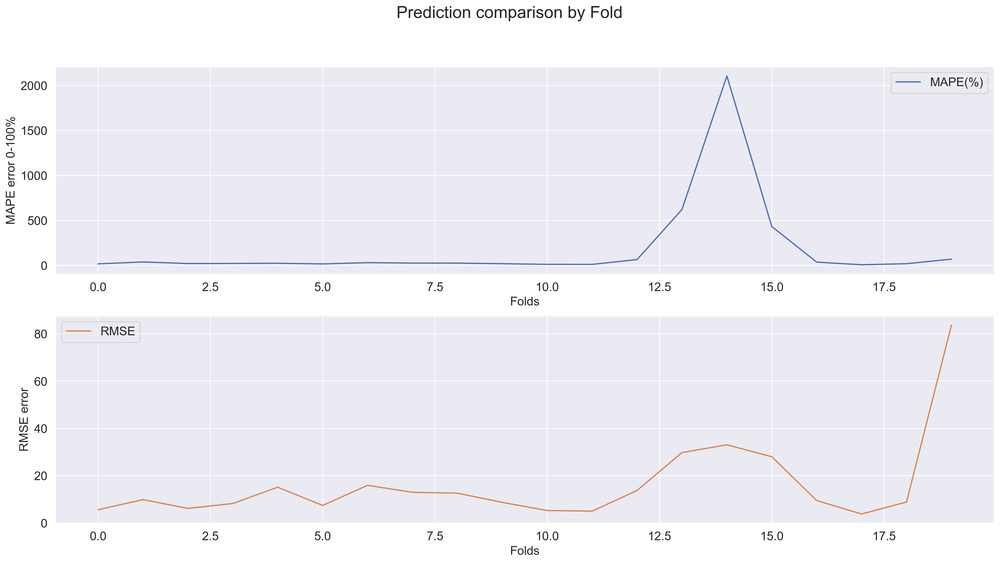

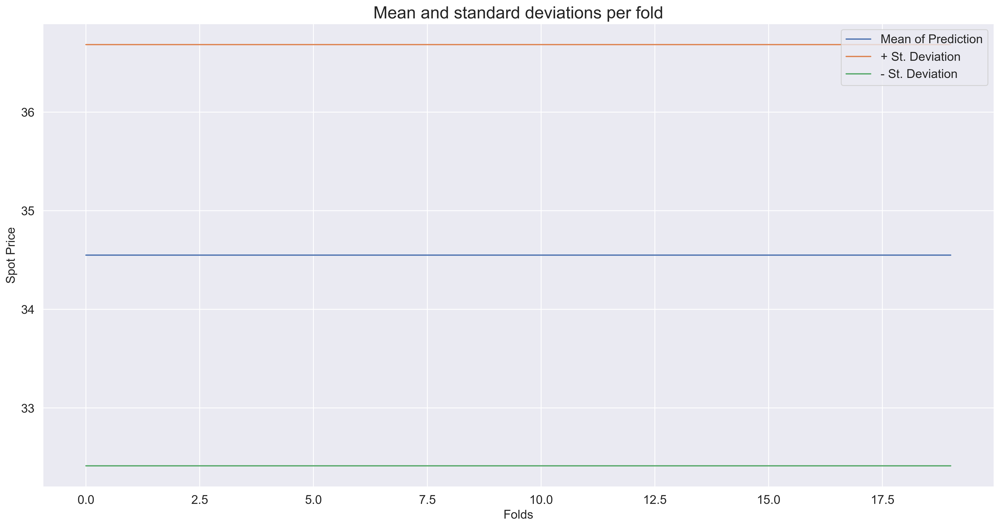

In [70]:
mape =[]
means = []
stdup = []
stddown = []
for ii in range(20):
    val = calculate_mape(base3[indexes[ii][0]:indexes[ii][1]]["price"], base3[indexes[ii][0]:indexes[ii][1]]["Naive price"])
    mape.append(val)
    means.append(np.mean(base3[indexes[ii][0]:indexes[ii][1]]["Naive price"]))
    stdup.append(np.mean(base3[indexes[ii][0]:indexes[ii][1]]["Naive price"]) + np.std(base3[indexes[ii][0]:indexes[ii][1]]["Naive price"]))
    stddown.append(np.mean(base3[indexes[ii][0]:indexes[ii][1]]["Naive price"]) - np.std(base3[indexes[ii][0]:indexes[ii][1]]["Naive price"]))
    print(f'Fold {ii+1} has  a MAPE of {val} % and an RMSE of {round(rmse[ii], 4)}')
print(f' Average MAPE: {np.mean(mape)}')
print(f' Average RMSE: {np.mean(rmse)}')



#f,(ax1,ax2,ax3,axca,ax4,axcb) = plt.subplots(1,6, 
#            gridspec_kw={'width_ratios':[1,1,1,0.08,1,0.08]})
#plt.subplots_adjust(left = 0.2, wspace=0.3)
#ax1.get_shared_y_axes().join(ax2,ax3,ax4)

plt.rcParams.update(params)

#MAPE(%) error by Fold
###### Error Plots ######    
fig, (ax1, ax2) = plt.subplots(2, 1)
plt.suptitle("Prediction comparison by Fold", fontsize=20)
ax1.set_xlabel('Folds')
ax1.set_ylabel('MAPE error 0-100%')
#a, = ax1.plot(mape, "C0", label = "MAPE(%)")
ax1.plot(mape, "C0", label = "MAPE(%)")
ax1.legend(loc='best')
#ax2 = ax1.twinx() # Adding Twin Axes
ax2.plot(rmse, "C1", label = "RMSE")
ax2.set_ylabel("RMSE error")
ax2.set_xlabel("Folds")
ax2.legend(loc='best')
#b, = ax2.plot(rmse, "C2", label = "RMSE")
#p = [a, b]
#ax1.legend(p, [p_.get_label() for p_ in p], loc= 'best')
plt.savefig(f'Plots/Naive Prediction 3 Errors per Fold.jpg')
plt.show()


###### Prediction Plots ######
fig3, ax3 = plt.subplots()   
ax3.set_xlabel('Folds') 
ax3.set_ylabel('Spot Price') 
ax3.plot(means, label = "Mean of Prediction")
ax3.plot((stdup), label = "+ St. Deviation")
ax3.plot((stddown), label = "- St. Deviation")
plt.title("Mean and standard deviations per fold", fontsize =20)
plt.legend()
plt.savefig(f'Plots/Naive Prediction 3 Mean and standard deviation.jpg')
plt.show()

FOR SARIMA

Fold 1 has  a MAPE of 8.35 % and an RMSE of 5.6094
Fold 2 has  a MAPE of 9.46 % and an RMSE of 9.8886
Fold 3 has  a MAPE of 28.13 % and an RMSE of 6.163
Fold 4 has  a MAPE of 34.55 % and an RMSE of 8.2454
Fold 5 has  a MAPE of 23.16 % and an RMSE of 15.1308
Fold 6 has  a MAPE of 9.5 % and an RMSE of 7.4221
Fold 7 has  a MAPE of 29.75 % and an RMSE of 15.9264
Fold 8 has  a MAPE of 8.16 % and an RMSE of 12.9648
Fold 9 has  a MAPE of 6.5 % and an RMSE of 12.6157
Fold 10 has  a MAPE of 5.94 % and an RMSE of 8.7046
Fold 11 has  a MAPE of 3.57 % and an RMSE of 5.2695
Fold 12 has  a MAPE of 10.66 % and an RMSE of 5.0029
Fold 13 has  a MAPE of 24.15 % and an RMSE of 13.7423
Fold 14 has  a MAPE of 18.68 % and an RMSE of 29.7858
Fold 15 has  a MAPE of 1.86 % and an RMSE of 33.0521
Fold 16 has  a MAPE of 54.69 % and an RMSE of 28.027
Fold 17 has  a MAPE of 10.59 % and an RMSE of 9.487
Fold 18 has  a MAPE of 7.84 % and an RMSE of 3.8088
Fold 19 has  a MAPE of 14.71 % and an RMSE of 8.8666
Fold 20 

NameError: name 'my_order' is not defined

<Figure size 3000x1500 with 0 Axes>

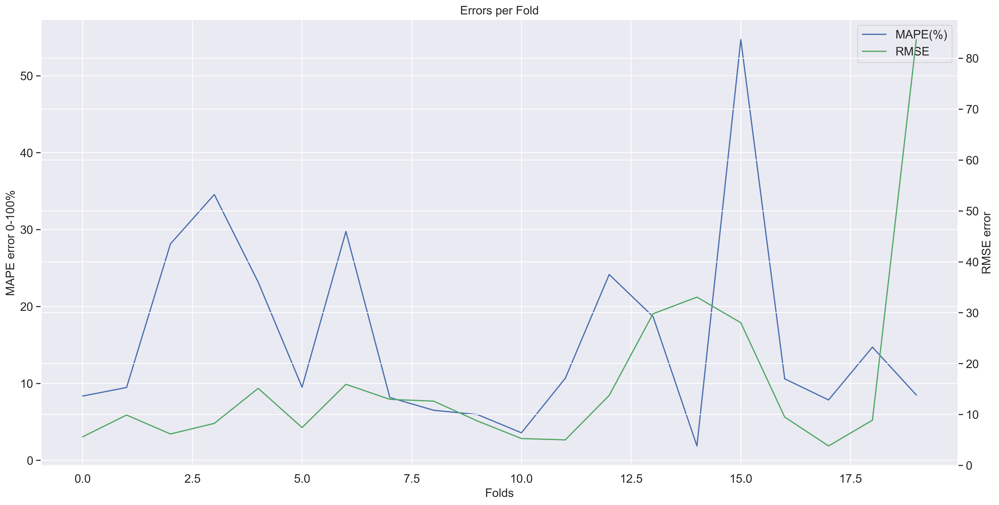

In [71]:
mape =[]
means = []
stdup = []
stddown = []
for ii in range(folds):
    val = calculate_mape(tdat[indexes[ii][0]:indexes[ii][1]], predsd[ii])
    mape.append(val)
    means.append(np.mean(predsd[ii]))
    stdup.append(np.mean(predsd[ii]) + np.std(predsd[ii]))
    stddown.append(np.mean(predsd[ii]) - np.std(predsd[ii]))
    print(f'Fold {ii+1} has  a MAPE of {val} % and an RMSE of {round(rmse[ii], 4)}')
print(f' Average MAPE: {np.mean(mape)}')
print(f' Average RMSE: {np.mean(rmse)}')

###### Error Plots ######    
plt.suptitle("Prediction comparison by Fold")
fig1, ax1 = plt.subplots()
ax1.set_xlabel('Folds')
ax1.set_ylabel('MAPE error 0-100%')
a, = ax1.plot(mape, "C0", label = "MAPE(%)")
ax2 = ax1.twinx() # Adding Twin Axes
ax2.set_ylabel("RMSE error")
b, = ax2.plot(rmse, "C2", label = "RMSE")
p = [a, b]
ax1.legend(p, [p_.get_label() for p_ in p], loc= 'best')
plt.title("Errors per Fold")
plt.savefig(f'Plots/Pred {my_order} Errors per Fold.jpg')
plt.show()


###### Prediction Plots ######
fig3, ax3 = plt.subplots()   
ax3.set_xlabel('Folds') 
ax3.set_ylabel('Spot Price') 
ax3.plot(means, label = "Mean of Prediction")
ax3.plot((stdup), label = "+ St. Deviation")
ax3.plot((stddown), label = "- St. Deviation")
plt.title("Mean and standard deviations per fold")
plt.legend()
plt.savefig(f'Plots/Pred {my_order} Mean and standard deviation.jpg')
plt.show()

## Time-related

In [73]:
    ### Only for baselines
    
    base3["RMSE"] = np.sqrt(((base3["Naive price"] - base3.price)**2).expanding().mean())
    folder= "Plots/base"
    filetype="preds.csv"
    
    #base3.to_csv(folder+str(3)+filetype)

In [74]:
base3.head()

,price,hour,month,day,Naive price,RMSE
datetime,,,,,,
2017-01-02 00:00:00,29.36,0,1,2,32.753324,3.393324
2017-01-02 01:00:00,29.40,1,1,2,32.553237,3.275481
2017-01-02 02:00:00,28.91,2,1,2,31.678806,3.115758
2017-01-02 03:00:00,28.11,3,1,2,31.070606,3.077703
2017-01-02 04:00:00,28.24,4,1,2,30.787409,2.979205


In [75]:
### Only for SARIMA

preds_df = step_rmse(predsd, tdat, 20)
folder = "Plots/"
subfolder = "sarimax/"
filename = "/Preds "
filetype = ".csv"
preds_df.to_csv(path_or_buf=folder+subfolder+my_order+filename+my_order+filetype)
preds_df.head()

NameError: name 'my_order' is not defined

Continue with base df or preds_df // Check naming of Plots!

hour
0     11.058848
1     11.058861
2     11.058795
3     11.058772
4     11.058705
5     11.058619
6     11.058600
7     11.058669
8     11.059392
9     11.060540
10    11.061282
11    11.061870
12    11.062204
13    11.062482
14    11.062715
15    11.062924
16    11.063484
17    11.064547
18    11.065986
19    11.067220
20    11.067631
21    11.067865
22    11.068049
23    11.068204
Name: RMSE, dtype: float64

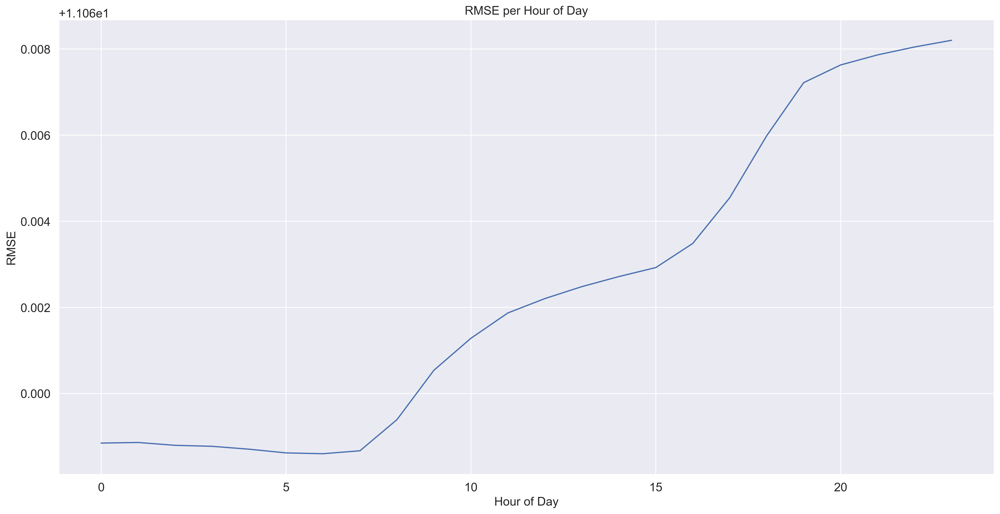

In [77]:
plt.rcParams.update(params)
hour_preds = base3.groupby("hour")["RMSE"].mean()
display(hour_preds)
plt.plot(hour_preds,"C0")
plt.xlabel('Hour of Day') 
plt.ylabel('RMSE') 
plt.title("RMSE per Hour of Day")
plt.savefig(f'Plots/Naive Prediction 3 Hourly error.jpg')
#plt.savefig(f'Plots/Pred {my_order} Hourly error.jpg', bbox_inches='tight', dpi=150)
plt.show()

In [80]:
base3.head()

,price,hour,month,day,Naive price,RMSE
datetime,,,,,,
2017-01-02 00:00:00,29.36,0,1,2,32.753324,3.393324
2017-01-02 01:00:00,29.40,1,1,2,32.553237,3.275481
2017-01-02 02:00:00,28.91,2,1,2,31.678806,3.115758
2017-01-02 03:00:00,28.11,3,1,2,31.070606,3.077703
2017-01-02 04:00:00,28.24,4,1,2,30.787409,2.979205


dayofweek
0    11.044282
1    11.051130
2    11.061418
3    11.077772
4    11.063529
5    11.066856
6    11.071484
Name: RMSE, dtype: float64

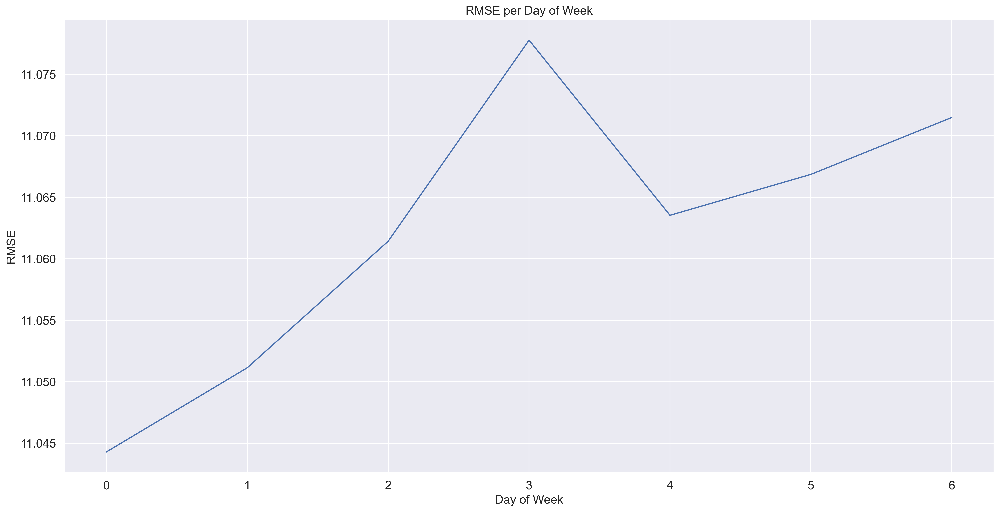

In [81]:
base3.reset_index(inplace=True)
base3["dayofweek"] = base3["datetime"].dt.dayofweek
weekday_preds = base3.groupby("dayofweek")["RMSE"].mean()
display(weekday_preds)
plt.plot(weekday_preds,"C0")
plt.xlabel('Day of Week') 
plt.ylabel('RMSE') 
plt.title("RMSE per Day of Week")
plt.savefig(f'Plots/Naive Prediction 3 Day of Week error.jpg')
#plt.savefig(f'Plots/Pred {my_order} Day of Week error.jpg', bbox_inches='tight', dpi=150)
plt.show()

dayofweek,0,1,2,3,4,5,6
hour,,,,,,,
0,11.043620,11.048873,11.056118,11.066528,11.062609,11.065390,11.068878
1,11.043196,11.048932,11.056570,11.066621,11.062536,11.065373,11.068883
2,11.042580,11.048900,11.056854,11.066680,11.062425,11.065329,11.068881
3,11.042437,11.048837,11.057060,11.066702,11.062301,11.065276,11.068875
4,11.042037,11.048763,11.057239,11.066705,11.062170,11.065220,11.068886
5,11.041411,11.048679,11.057445,11.066711,11.062040,11.065183,11.068949
6,11.040857,11.048651,11.057780,11.066737,11.061924,11.065190,11.069143
7,11.040330,11.048640,11.058239,11.066871,11.061903,11.065307,11.069474
8,11.041329,11.049069,11.059127,11.068330,11.062211,11.065700,11.070059


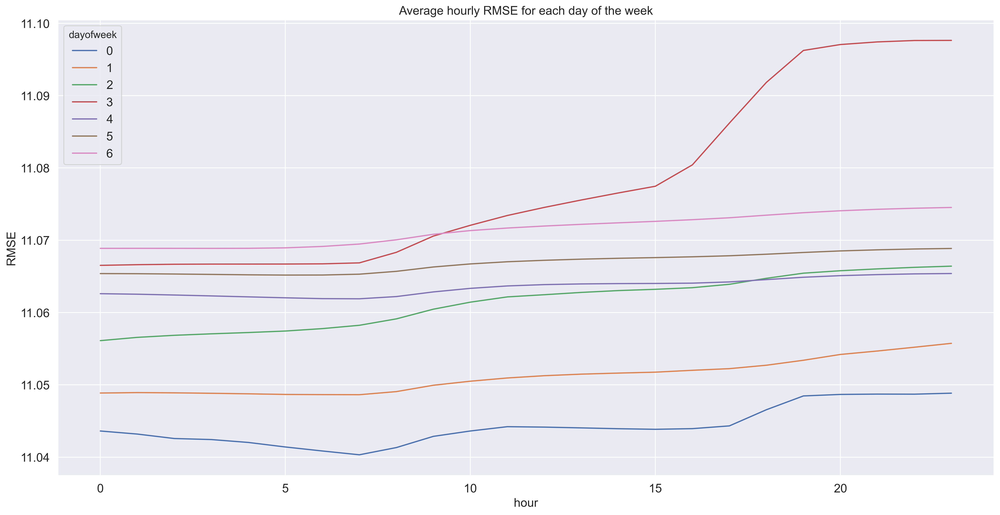

In [82]:
hour_day = pd.pivot_table(data = base3, values="RMSE",
                            index = "hour", columns="dayofweek",
                            aggfunc="mean")
display(hour_day)
hour_day.plot()
plt.ylabel("RMSE")
plt.title("Average hourly RMSE for each day of the week")
#plt.savefig(f'Plots/Naive Prediction 1 Average hourly RMSE for each day.jpg')
plt.savefig(f'Plots/Naive Prediction 3 Average hourly RMSE for each day.jpg')
plt.show()

## Revenue

In [275]:
######## Average Weekly gain of Forecasting ########   
preds_df=revenue(preds_df, folds, mape, test_size)
preds_df.head()
#import inspect
#print(inspect.getsource(revenue))


fourdaypred = preds_df.price_loss.sum() / folds
print(f'The average revenue of predicting the price for NO1 is {np.round(2*fourdaypred, 4)} €/MWh')

"""
5 areas in NO, 2 in DK, 1 in FI, 4 in SE == 12 areas + DE, NL, BE, AU, UK __APROX. 20__
"""
print(f'The roughly estimated revenue generated of predicting '
      f'the price for all markets is {np.round(52*20*2*fourdaypred, 4)} €')

The average weekly revenue of predicting the price for NO1 is 25.5139 €
The roughly estimated revenue generated of predicting the price for all markets is 26534.4942 €


In [47]:
#import inspect
print(inspect.getsource(revenue))

def revenue(df, folds, mape, test_size, **args):
    
    """ Function to calculate price difference and impact
        of the MAPE on the smar charging-related revenue
    """
    
    
    ######## Get Price difference ######## """Actual Price - Predicted Price"""
    df["pricediff"] = df.price - df["Predicted Price"]

    ######## Get MAPE Column ########
    mape_cols = [str(c) for c in range(folds)]
    mapedf= pd.DataFrame(columns = mape_cols, index = range(test_size))
    mapedf=mapedf.assign(**dict(zip(mape_cols, mape)))
    mape_list = []
    for _, ro in mapedf.T.iterrows():
        mape_list.extend(ro.values)
    df["mape"] = mape_list

    ######## Get Price Loss ########
    df["price_loss"]= df.pricediff * df.mape / 100

    return df

